In [1]:
import random
import os.path
import tensorflow as tf
import warnings
from distutils.version import LooseVersion
import numpy as np
import scipy.misc
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

import FCNN_model as vgg19
import helper
import labels

In [2]:
print('TensorFlow Version: {}'.format(tf.__version__))

TensorFlow Version: 1.2.1


In [3]:
# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

Default GPU Device: /gpu:0


In [4]:
def optimize(logits, predictions, correct_labels, learning_rate, num_classes):
    labels = tf.argmax(correct_labels, axis=-1)
    pred_labels = tf.argmax(predictions, axis=-1)
    iou, iou_op = tf.metrics.mean_iou(labels, pred_labels, num_classes)
    cross_entropy_loss = tf.reduce_mean(tf.nn.softmax_cross_entropy_with_logits(logits=logits, labels=correct_labels))
    reg_constant = 0.05
    loss = cross_entropy_loss + reg_constant*tf.reduce_sum(tf.get_collection(tf.GraphKeys.REGULARIZATION_LOSSES))
    train_op = tf.train.AdamOptimizer(learning_rate).minimize(loss)

    return iou, iou_op, logits, loss, train_op

In [5]:
def train_nn(epochs, batch_size, n_classes, img_shape, mask_shape, learning_rate, get_batches_fn, 
             orig_shape, display_val, load_dir, save_dir):
    total_steps = 0
    print_every = 5
    best_iou = 0.0
    
    x = tf.placeholder(tf.float32, [None, img_shape[0], img_shape[1], 3], name='x')
    y = tf.placeholder(tf.float32, [None, mask_shape[0], mask_shape[1], n_classes], name='y')
    train_mode = tf.placeholder(tf.bool, name='train_mode')
        
    vgg = vgg19.Vgg19(vgg19_npy_path='vgg19.npy', 
                      trainable=True, dropout=0.5,
                      image_shape=img_shape, num_classes=n_classes)
    
    vgg.build(x, train_mode)
    iou, iou_op, logits, cross_entropy_loss, train_op = optimize(vgg.logits, vgg.preds, y, 
                                                                 learning_rate, n_classes)
    
    saver = tf.train.Saver(max_to_keep=5)
    
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        sess.run(tf.local_variables_initializer())

        if load_dir is not None:
            saver.restore(sess, tf.train.latest_checkpoint(load_dir))
        
        for e in range(epochs):
            train_losses = []
            train_ious = []
            valid_losses = []
            valid_ious = []
            
            steps = 0
            for batch_x, batch_y, steps_per_epoch in get_batches_fn(batch_size, mode='train'):
                steps += 1
                total_steps += 1
                feed = {x: batch_x,
                        y: batch_y,
                        train_mode: True}
                _, batch_iou, batch_loss, _ = sess.run([iou_op, iou, cross_entropy_loss, train_op], feed_dict=feed)

                train_losses.append(batch_loss)
                train_ious.append(batch_iou)
                
                if steps % print_every == 0:
                    avg_loss = np.mean(train_losses)
                    avg_iou = np.mean(train_ious)
                    print('Epoch {}/{}. . . Steps {}/{}. . . Train Loss {:.4}. . . Train IOU {:.4}'.format(e+1, epochs, 
                                                                                      steps, steps_per_epoch, 
                                                                                      avg_loss, avg_iou))
            
            if (e+1)%2 == 0:
                cnt = 0
                valid_preds = None
                valid_x = None
                valid_y = None
                for batch_x, batch_y, _ in get_batches_fn(batch_size, mode='val'):
                    cnt += 1  
                    feed = {x: batch_x,
                            y: batch_y,
                            train_mode: False}
                    batch_preds, _, batch_iou, batch_loss, _ = sess.run([vgg.preds, iou_op, iou, 
                                                                         cross_entropy_loss, train_op], 
                                                                        feed_dict=feed)

                    valid_losses.append(batch_loss)
                    valid_ious.append(batch_iou)
                    if valid_preds is not None:
                        valid_preds = np.concatenate((valid_preds, batch_preds), axis=0)
                        valid_x = np.concatenate((valid_x, batch_x), axis=0)
                        valid_y = np.concatenate((valid_y, batch_y), axis=0)

                    else:
                        valid_preds = batch_preds
                        valid_x = batch_x
                        valid_y = batch_y

                avg_valid_loss = np.mean(valid_losses)
                avg_valid_iou = np.mean(valid_ious)
                print('')
                print('Epoch {}/{}. . . Valid Loss {:.4}. . . Valid IOU {:.4}'.format(e+1, epochs, 
                                                                                      avg_valid_loss, avg_valid_iou))

                if avg_valid_iou > best_iou:
                    saver.save(sess, save_dir+'/fcnn_model', global_step=e+1)
                    print('Model Saved!')
                    best_iou = avg_valid_iou
                
            
                if display_val:
                    print('Displaying example validation predictions...')
                    temp_idx = np.arange(len(valid_x))
                    random.shuffle(temp_idx)
                    disp_idx = temp_idx[:3]
                    
                    if n_classes != 30:
                        temp_x = valid_x[disp_idx]
                        temp_y = valid_y[disp_idx]
                        temp_preds = valid_preds[disp_idx]
                        view_y = np.zeros((temp_y.shape[0], temp_y.shape[1], temp_y.shape[2], 30))
                        view_y0 = np.ones_like(temp_y[:,:,:,0]) - temp_y[:,:,:,0]
                        view_y[:,:,:,0] = view_y0
                        view_y[:,:,:,3] = temp_y[:,:,:,0]

                        view_preds = np.zeros((temp_preds.shape[0], temp_preds.shape[1], temp_preds.shape[2], 30))
                        view_preds0 = np.ones_like(temp_preds[:,:,:,0]) - temp_preds[:,:,:,0]
                        view_preds[:,:,:,0] = view_preds0
                        view_preds[:,:,:,3] = temp_preds[:,:,:,0]
                        
                        _ = [helper.view_val_egs(temp_x[i], view_y[i], view_preds[i], 30, orig_shape=orig_shape)
                             for i in range(len(temp_x))]
                             
                    else:
                        _ = [helper.view_val_egs(valid_x[idx], valid_y[idx], valid_preds[idx], 30) 
                             for idx in disp_idx]
                         
            saver.save(sess, save_dir+'/fcnn_model', global_step=e+1)
            print('Model Saved!')
            print('')
            print('') 
    print('Model finished training :)')
    
    return valid_x, valid_y, valid_preds

In [6]:
# You will have to change the data_folder argument to where you stored the cityscapes or KITTI data
def run(mode='cityscapes', display_val=True, load_dir='checks3', save_dir='checks4'):
    if mode == 'cityscapes':
        epochs = 2
        batch_size = 10
        n_classes = 30
        orig_shape = (1024, 2048)
        img_shape = (256,512)
        mask_shape= (256,512)
        learning_rate = 0.0001
        data_dir = '/home/ubuntu/CarND-Semantic-Segmentation/data/cityscapes'
        get_batches_fn = helper.gen_batch_function(data_folder='/home/ubuntu/CarND-Semantic-Segmentation/data/cityscapes',
                                                   image_shape=img_shape, mask_shape=mask_shape, 
                                                   num_classes=n_classes)
        with tf.Graph().as_default():
            valid_x, valid_y, valid_preds = train_nn(epochs, batch_size, n_classes, img_shape, mask_shape,
                                                     learning_rate, get_batches_fn, orig_shape, display_val, 
                                                     load_dir, save_dir)

    elif mode == 'KITTI':
        epochs = 50
        batch_size = 10
        n_classes = 2
        orig_shape = (375, 1242)
        img_shape = (256, 856)
        mask_shape = (256, 856)
        learning_rate = 0.0001
        get_batches_fn = helper.gen_batch_function_KITTI(data_folder='/home/ubuntu/CarND-Semantic-Segmentation/data/training', 
                                                         image_shape=img_shape, mask_shape=img_shape, 
                                                         num_classes=n_classes)
        
        with tf.Graph().as_default():
            valid_x, valid_y, valid_preds = train_nn(epochs, batch_size, n_classes, img_shape, mask_shape, 
                                                     learning_rate, get_batches_fn, orig_shape, display_val, 
                                                     load_dir, save_dir)
    
    else:
        print('Please enter valid mode (either <cityscapes> or <KITTI>)')
    
    return valid_x, valid_y, valid_preds

INFO:tensorflow:Restoring parameters from checks11/fcnn_model-10
Epoch 1/2. . . Steps 5/298. . . Train Loss 0.3653. . . Train IOU 0.3125
Epoch 1/2. . . Steps 10/298. . . Train Loss 0.3536. . . Train IOU 0.3879
Epoch 1/2. . . Steps 15/298. . . Train Loss 0.3714. . . Train IOU 0.4135
Epoch 1/2. . . Steps 20/298. . . Train Loss 0.3744. . . Train IOU 0.4269
Epoch 1/2. . . Steps 25/298. . . Train Loss 0.3683. . . Train IOU 0.4348
Epoch 1/2. . . Steps 30/298. . . Train Loss 0.3615. . . Train IOU 0.4405
Epoch 1/2. . . Steps 35/298. . . Train Loss 0.3619. . . Train IOU 0.4454
Epoch 1/2. . . Steps 40/298. . . Train Loss 0.3614. . . Train IOU 0.449
Epoch 1/2. . . Steps 45/298. . . Train Loss 0.359. . . Train IOU 0.452
Epoch 1/2. . . Steps 50/298. . . Train Loss 0.3559. . . Train IOU 0.4546
Epoch 1/2. . . Steps 55/298. . . Train Loss 0.3528. . . Train IOU 0.4566
Epoch 1/2. . . Steps 60/298. . . Train Loss 0.3507. . . Train IOU 0.4585
Epoch 1/2. . . Steps 65/298. . . Train Loss 0.3493. . . Train I

Epoch 2/2. . . Steps 265/298. . . Train Loss 0.3501. . . Train IOU 0.4938
Epoch 2/2. . . Steps 270/298. . . Train Loss 0.3502. . . Train IOU 0.4939
Epoch 2/2. . . Steps 275/298. . . Train Loss 0.35. . . Train IOU 0.4939
Epoch 2/2. . . Steps 280/298. . . Train Loss 0.3497. . . Train IOU 0.494
Epoch 2/2. . . Steps 285/298. . . Train Loss 0.3501. . . Train IOU 0.494
Epoch 2/2. . . Steps 290/298. . . Train Loss 0.3509. . . Train IOU 0.4941
Epoch 2/2. . . Steps 295/298. . . Train Loss 0.3506. . . Train IOU 0.4941

Epoch 2/2. . . Valid Loss 0.3798. . . Valid IOU 0.4955
Model Saved!
Displaying example validation predictions...


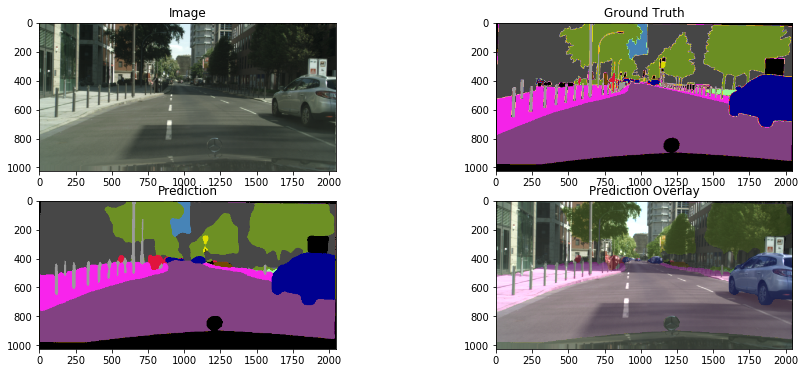

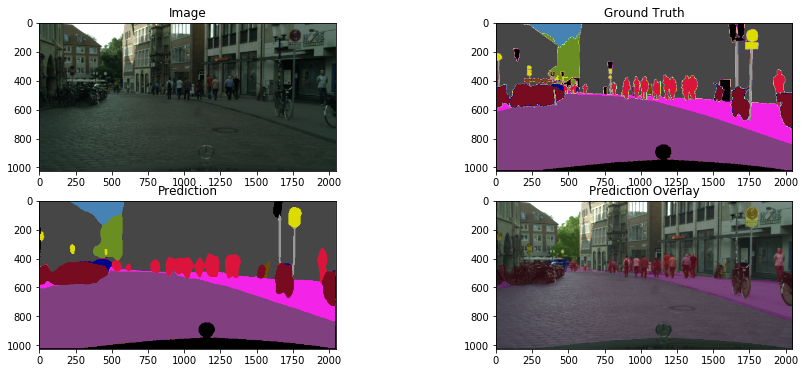

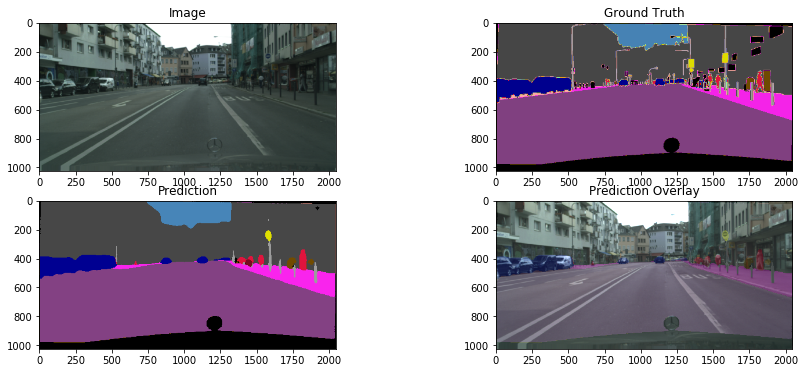

Model Saved!


Model finished training :)


In [7]:
valid_x, valid_y, valid_preds = run(mode='cityscapes', display_val=True, load_dir='checks11', save_dir='checks12')

In [15]:
correct_road = 0
correct_car = 0
correct_traffic_sign = 0
correct_person = 0
for i in range(len(valid_preds)):
    pred = np.argmax(valid_preds[i], axis=-1)
    pred_road = np.zeros_like(pred)
    pred_road[pred==3] = 1
    #pred_road = valid_preds[i,:,:, 3]
    label_road = valid_y[i,:,:, 3]
    combined_road = pred_road + label_road
    vals_road, cnts_road = np.unique(combined_road, return_counts=True)
    
    pred_car = np.zeros_like(pred)
    pred_car[pred==21] = 1
    #pred_car = valid_preds[i,:,:, 21]
    label_car = valid_y[i,:,:, 21]
    combined_car = pred_car + label_car
    vals_car, cnts_car = np.unique(combined_car, return_counts=True)
    
    pred_traffic_sign = np.zeros_like(pred)
    pred_traffic_sign[pred==15] = 1
    #pred_traffic_sign = valid_preds[i,:,:, 15]
    label_traffic_sign = valid_y[i,:,:, 15]
    combined_traffic_sign = pred_traffic_sign + label_traffic_sign
    vals_traffic_sign, cnts_traffic_sign = np.unique(combined_traffic_sign, return_counts=True)
    
    pred_person = np.zeros_like(pred)
    pred_person[pred==19] = 1
    #pred_person = valid_preds[i,:,:, 19]
    label_person = valid_y[i,:,:, 19]
    combined_person = pred_person + label_person
    vals_person, cnts_person = np.unique(combined_person, return_counts=True)
    
    n_cor_road = 0
    n_cor_car = 0
    n_cor_person = 0
    n_cor_traffic_sign = 0
    for j in range(len(vals_road)):
        if vals_road[j] == 2:
            n_cor_road = cnts_road[j]
    for j in range(len(vals_car)):    
        if vals_car[j] == 2:
            n_cor_car = cnts_car[j]
    for j in range(len(vals_traffic_sign)):        
        if vals_traffic_sign[j] == 2:
            n_cor_traffic_sign = cnts_traffic_sign[j]
    for j in range(len(vals_person)):          
        if vals_person[j] == 2:
            n_cor_person = cnts_person[j]
            
    try:
        per_road = n_cor_road / len(label_road[label_road==1])
    except:
        per_road = 1
    try: 
        per_car = n_cor_car / len(label_car[label_car==1])
    except:
        per_car = 1
    try:
        per_traffic_sign = n_cor_traffic_sign / len(label_traffic_sign[label_traffic_sign==1])
    except:
        per_traffic_sign = 1
    try:
        per_person = n_cor_person / len(label_person[label_person==1])
    except:
        per_person = 1
    
    correct_road += per_road
    correct_car += per_car
    correct_traffic_sign += per_traffic_sign
    correct_person += per_person

correct_road /= len(valid_preds)
correct_car /= len(valid_preds)
correct_traffic_sign /= len(valid_preds)
correct_person /= len(valid_preds)

print('Percent of road labelled correctly: {:.2f}%'.format(correct_road*100))
print('Percent of cars labelled correctly: {:.2f}%'.format(correct_car*100))
print('Percent of traffic_signs labelled correctly: {:.2f}%'.format(correct_traffic_sign*100))
print('Percent of persons labelled correctly: {:.2f}%'.format(correct_person*100))

Percent of road labelled correctly: 95.29%
Percent of cars labelled correctly: 87.35%
Percent of traffic_signs labelled correctly: 28.29%
Percent of persons labelled correctly: 40.25%


INFO:tensorflow:Restoring parameters from checks_KITTI/fcnn_model-11
Epoch 12/100. . . Steps 5/26. . . Train Loss 0.05418. . . Train IOU 0.7362
Epoch 12/100. . . Steps 10/26. . . Train Loss 0.05015. . . Train IOU 0.8316
Epoch 12/100. . . Steps 15/26. . . Train Loss 0.04834. . . Train IOU 0.8631
Epoch 12/100. . . Steps 20/26. . . Train Loss 0.04852. . . Train IOU 0.8789
Epoch 12/100. . . Steps 25/26. . . Train Loss 0.04671. . . Train IOU 0.8883

Epoch 12/100. . . Valid Loss 0.06611. . . Valid IOU 0.926
Model Saved!
Displaying example validation predictions...


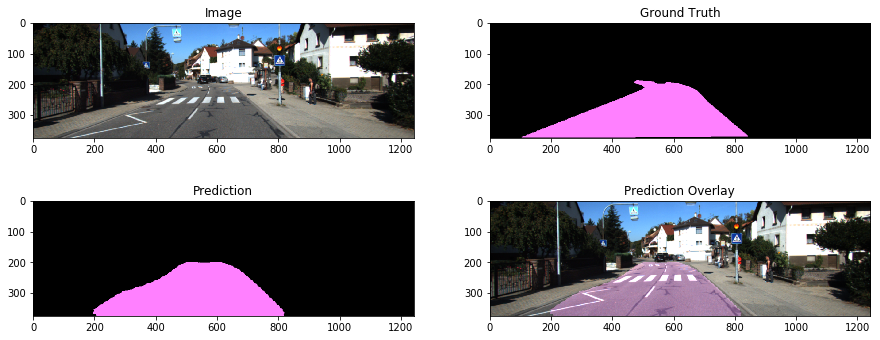

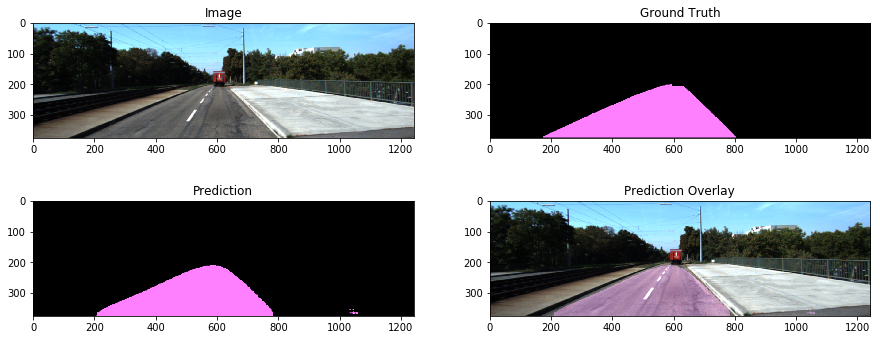

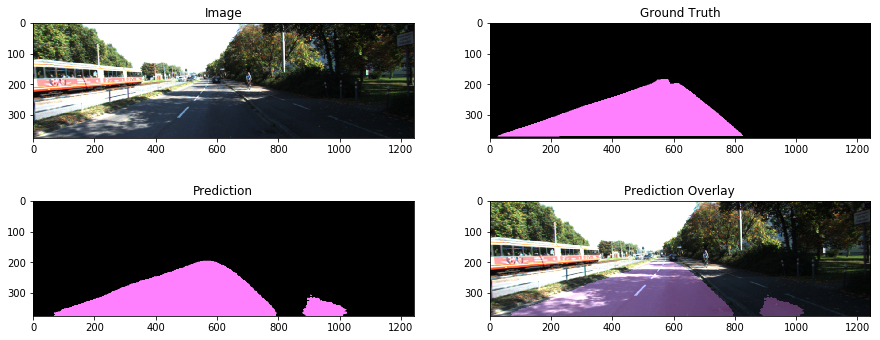



Epoch 13/100. . . Steps 5/26. . . Train Loss 0.04689. . . Train IOU 0.9248
Epoch 13/100. . . Steps 10/26. . . Train Loss 0.04274. . . Train IOU 0.9251
Epoch 13/100. . . Steps 15/26. . . Train Loss 0.04071. . . Train IOU 0.9255
Epoch 13/100. . . Steps 20/26. . . Train Loss 0.04332. . . Train IOU 0.9258
Epoch 13/100. . . Steps 25/26. . . Train Loss 0.04152. . . Train IOU 0.9261

Epoch 13/100. . . Valid Loss 0.0631. . . Valid IOU 0.9273
Model Saved!
Displaying example validation predictions...


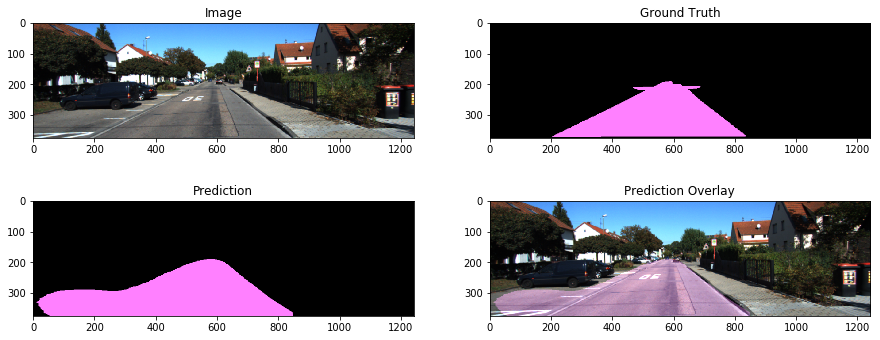

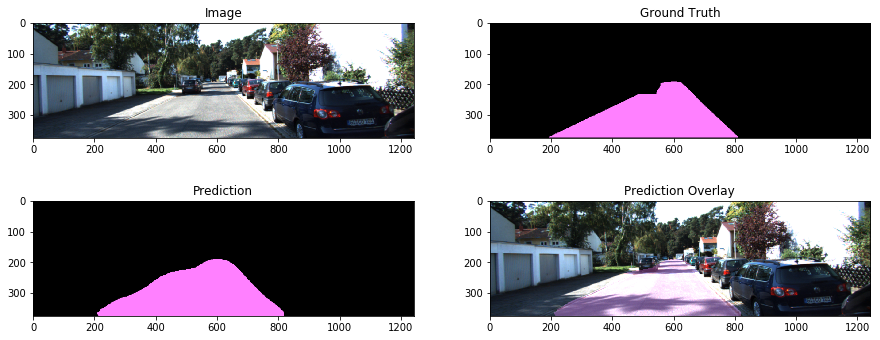

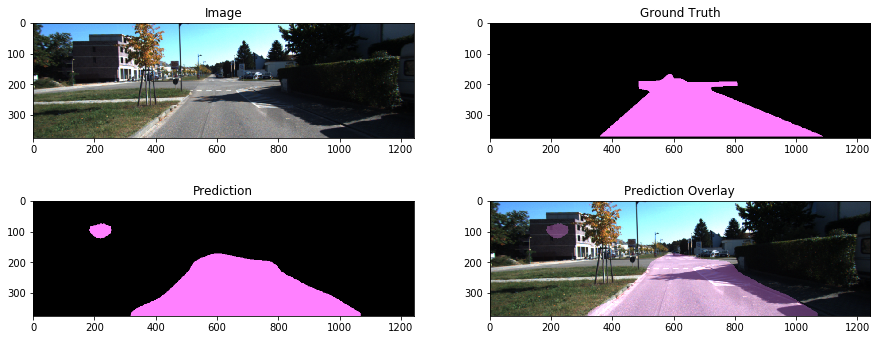



Epoch 14/100. . . Steps 5/26. . . Train Loss 0.04636. . . Train IOU 0.9264
Epoch 14/100. . . Steps 10/26. . . Train Loss 0.03813. . . Train IOU 0.9266
Epoch 14/100. . . Steps 15/26. . . Train Loss 0.03692. . . Train IOU 0.927
Epoch 14/100. . . Steps 20/26. . . Train Loss 0.03709. . . Train IOU 0.9275
Epoch 14/100. . . Steps 25/26. . . Train Loss 0.03667. . . Train IOU 0.9281

Epoch 14/100. . . Valid Loss 0.05512. . . Valid IOU 0.9312
Model Saved!
Displaying example validation predictions...


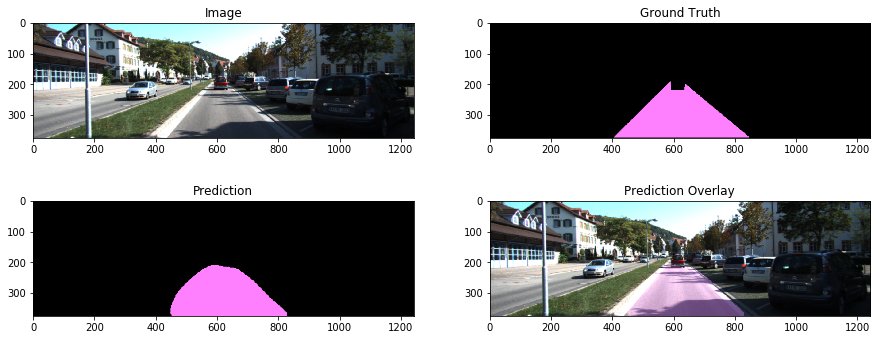

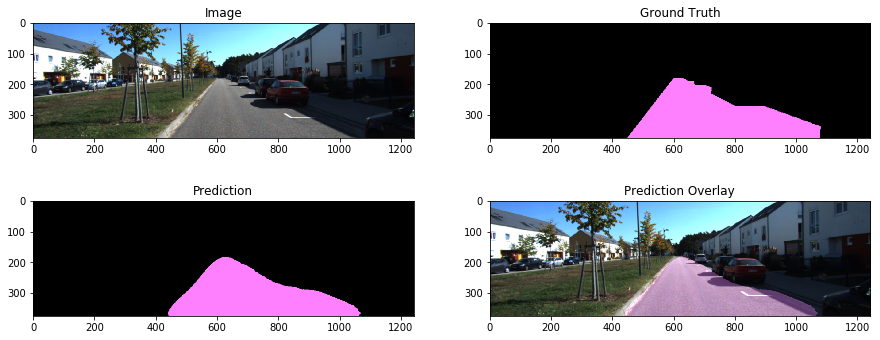

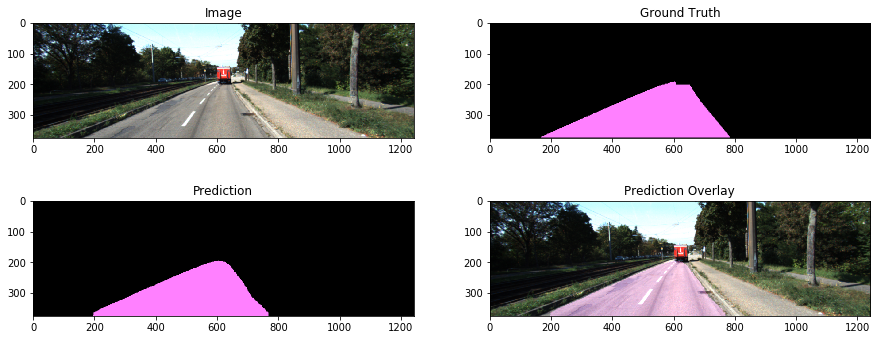



Epoch 15/100. . . Steps 5/26. . . Train Loss 0.04542. . . Train IOU 0.9312
Epoch 15/100. . . Steps 10/26. . . Train Loss 0.04023. . . Train IOU 0.9314
Epoch 15/100. . . Steps 15/26. . . Train Loss 0.03664. . . Train IOU 0.9316
Epoch 15/100. . . Steps 20/26. . . Train Loss 0.03592. . . Train IOU 0.9318
Epoch 15/100. . . Steps 25/26. . . Train Loss 0.03482. . . Train IOU 0.932

Epoch 15/100. . . Valid Loss 0.05018. . . Valid IOU 0.9338
Model Saved!
Displaying example validation predictions...


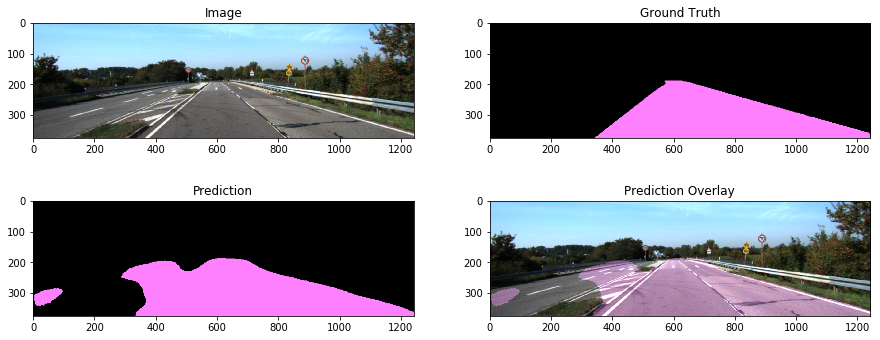

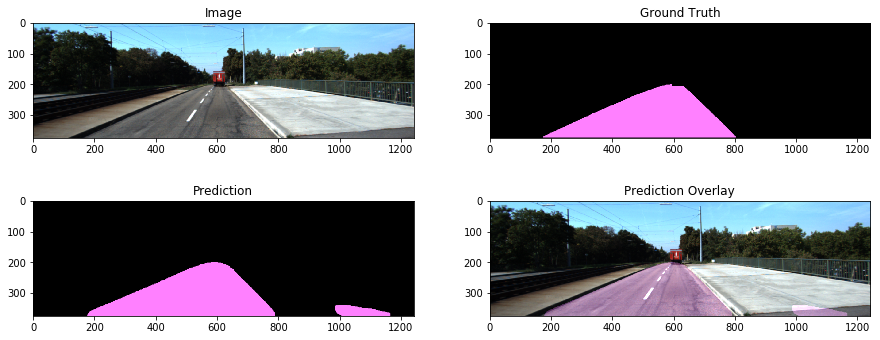

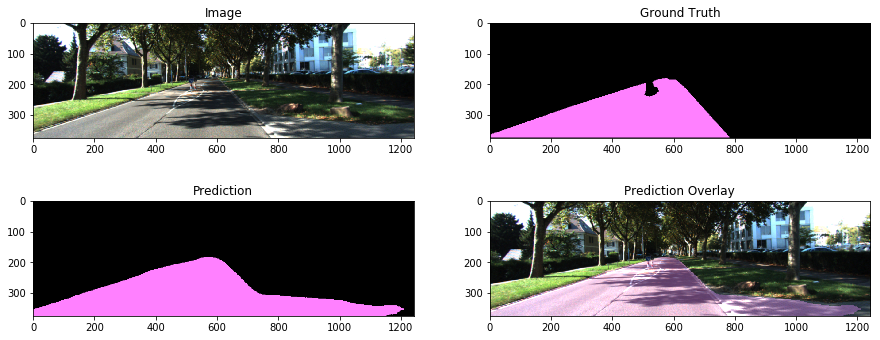



Epoch 16/100. . . Steps 5/26. . . Train Loss 0.02893. . . Train IOU 0.9337
Epoch 16/100. . . Steps 10/26. . . Train Loss 0.02952. . . Train IOU 0.9341
Epoch 16/100. . . Steps 15/26. . . Train Loss 0.02985. . . Train IOU 0.9343
Epoch 16/100. . . Steps 20/26. . . Train Loss 0.03101. . . Train IOU 0.9346
Epoch 16/100. . . Steps 25/26. . . Train Loss 0.03024. . . Train IOU 0.9349

Epoch 16/100. . . Valid Loss 0.04224. . . Valid IOU 0.9367
Model Saved!
Displaying example validation predictions...


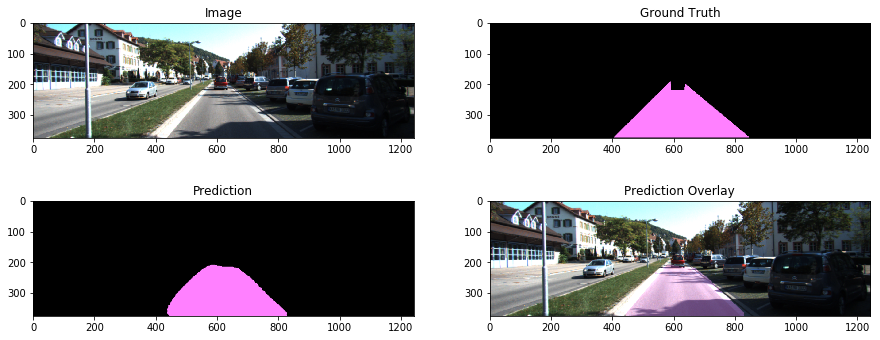

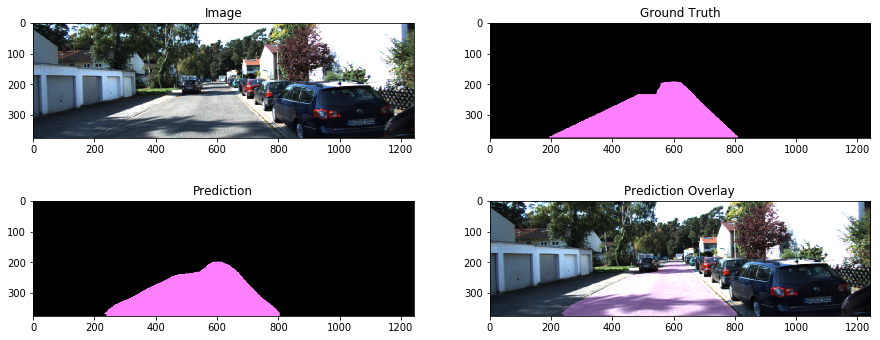

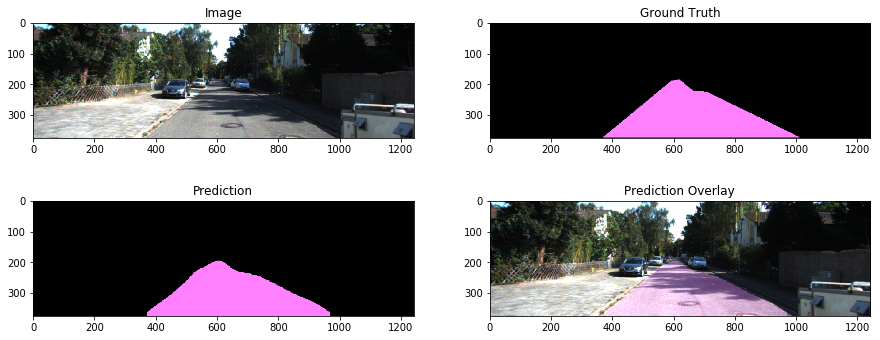



Epoch 17/100. . . Steps 5/26. . . Train Loss 0.03449. . . Train IOU 0.937
Epoch 17/100. . . Steps 10/26. . . Train Loss 0.03178. . . Train IOU 0.9371
Epoch 17/100. . . Steps 15/26. . . Train Loss 0.03151. . . Train IOU 0.9373
Epoch 17/100. . . Steps 20/26. . . Train Loss 0.03114. . . Train IOU 0.9376
Epoch 17/100. . . Steps 25/26. . . Train Loss 0.03085. . . Train IOU 0.9379

Epoch 17/100. . . Valid Loss 0.03639. . . Valid IOU 0.9394
Model Saved!
Displaying example validation predictions...


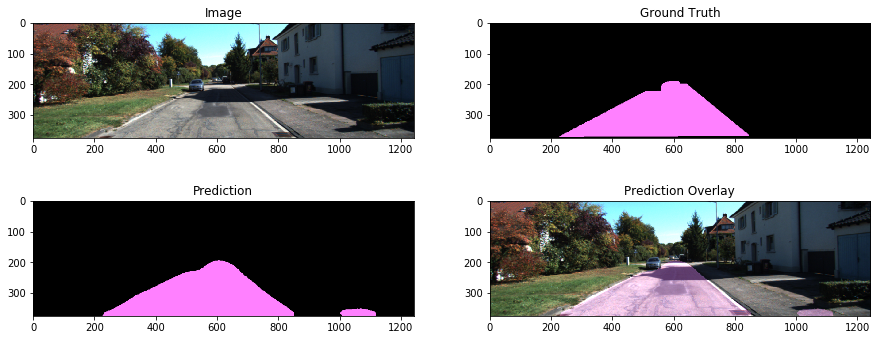

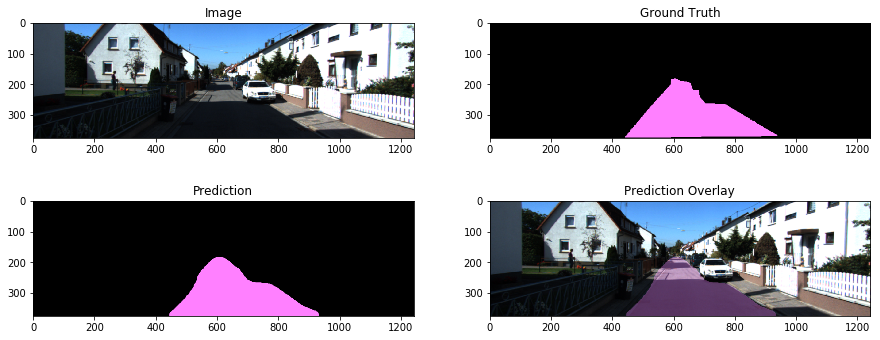

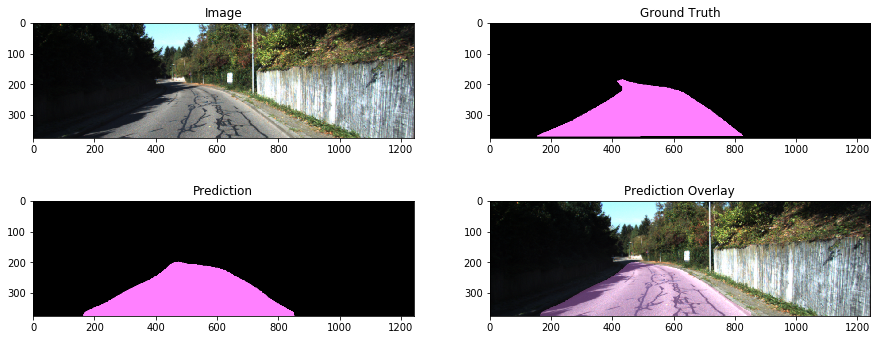



Epoch 18/100. . . Steps 5/26. . . Train Loss 0.02717. . . Train IOU 0.9396
Epoch 18/100. . . Steps 10/26. . . Train Loss 0.02582. . . Train IOU 0.9399
Epoch 18/100. . . Steps 15/26. . . Train Loss 0.02638. . . Train IOU 0.9401
Epoch 18/100. . . Steps 20/26. . . Train Loss 0.02652. . . Train IOU 0.9403
Epoch 18/100. . . Steps 25/26. . . Train Loss 0.02685. . . Train IOU 0.9405

Epoch 18/100. . . Valid Loss 0.03557. . . Valid IOU 0.9416
Model Saved!
Displaying example validation predictions...


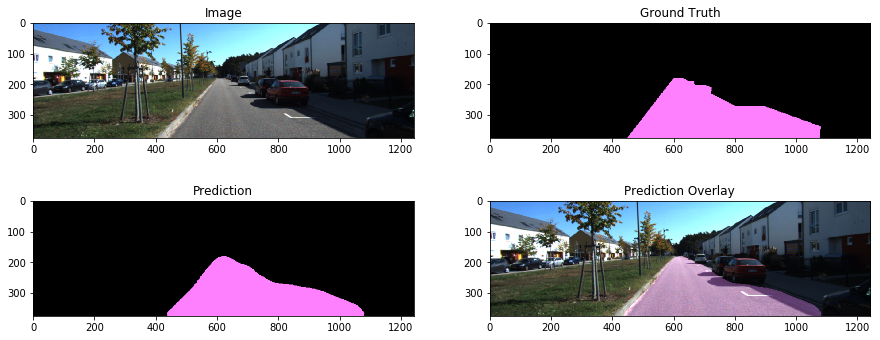

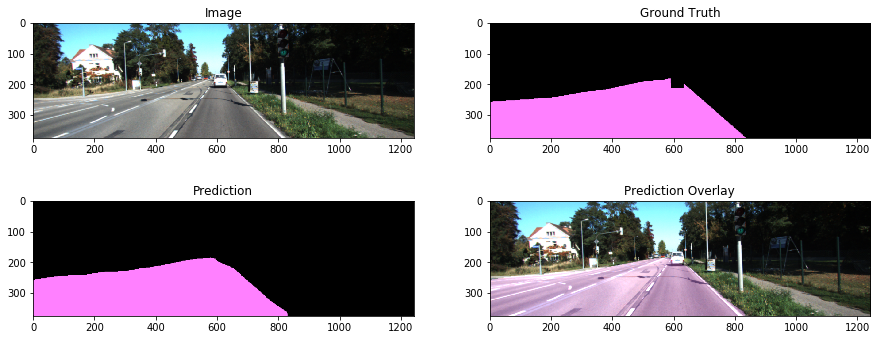

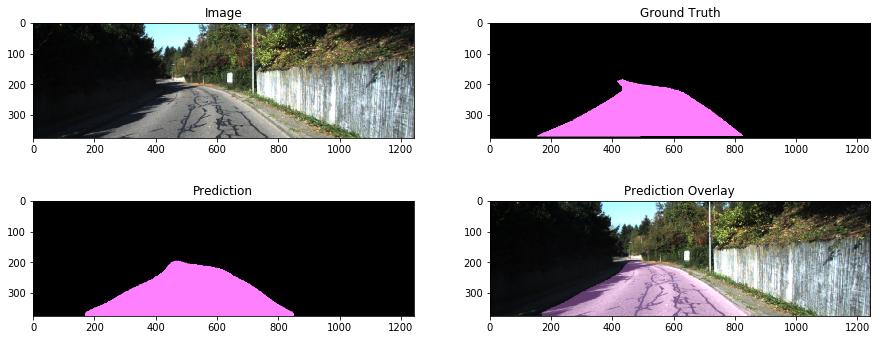



Epoch 19/100. . . Steps 5/26. . . Train Loss 0.02719. . . Train IOU 0.9418
Epoch 19/100. . . Steps 10/26. . . Train Loss 0.03032. . . Train IOU 0.9419
Epoch 19/100. . . Steps 15/26. . . Train Loss 0.02887. . . Train IOU 0.942
Epoch 19/100. . . Steps 20/26. . . Train Loss 0.02855. . . Train IOU 0.9422
Epoch 19/100. . . Steps 25/26. . . Train Loss 0.02756. . . Train IOU 0.9423

Epoch 19/100. . . Valid Loss 0.03244. . . Valid IOU 0.9434
Model Saved!
Displaying example validation predictions...


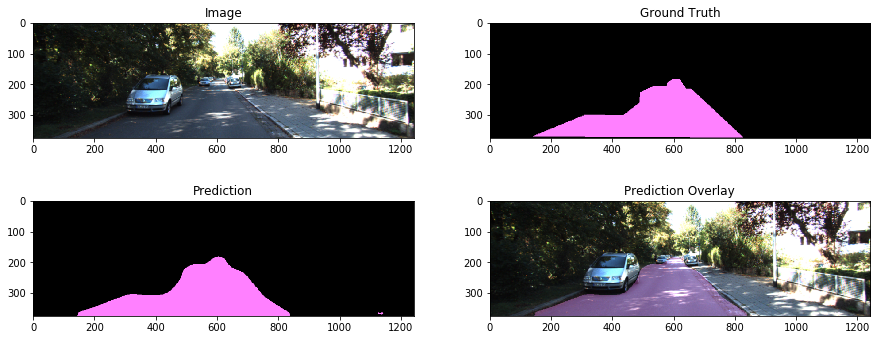

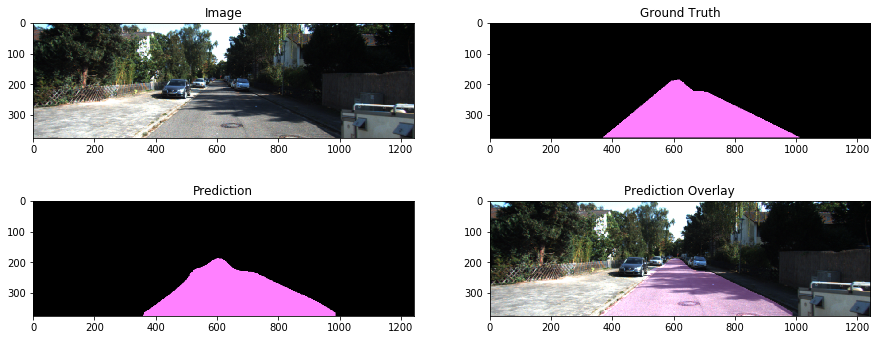

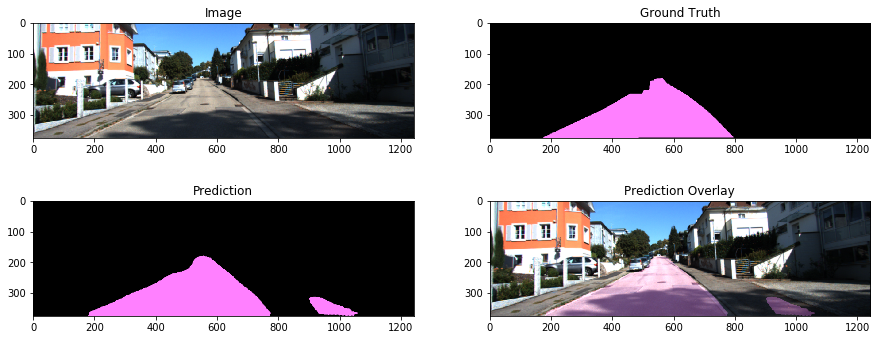



Epoch 20/100. . . Steps 5/26. . . Train Loss 0.02323. . . Train IOU 0.9436
Epoch 20/100. . . Steps 10/26. . . Train Loss 0.02324. . . Train IOU 0.9438
Epoch 20/100. . . Steps 15/26. . . Train Loss 0.02437. . . Train IOU 0.944
Epoch 20/100. . . Steps 20/26. . . Train Loss 0.02463. . . Train IOU 0.9441
Epoch 20/100. . . Steps 25/26. . . Train Loss 0.02471. . . Train IOU 0.9442

Epoch 20/100. . . Valid Loss 0.03262. . . Valid IOU 0.945
Model Saved!
Displaying example validation predictions...


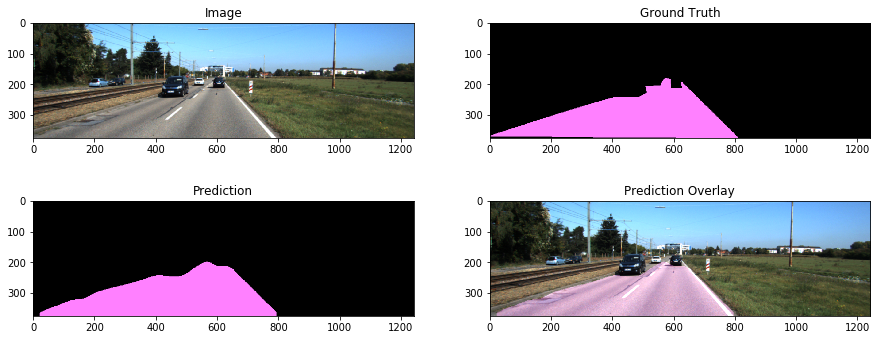

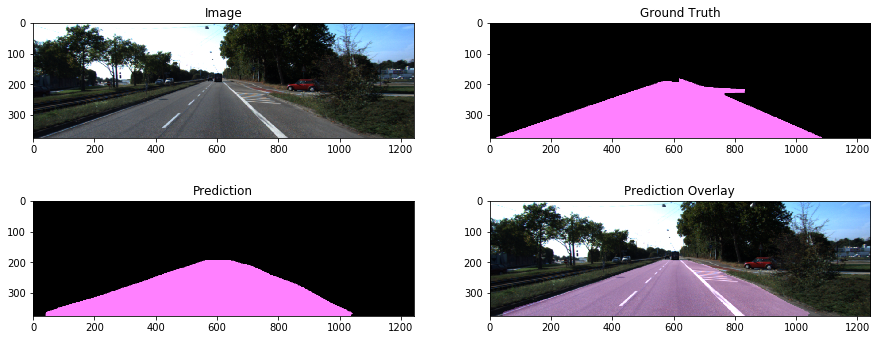

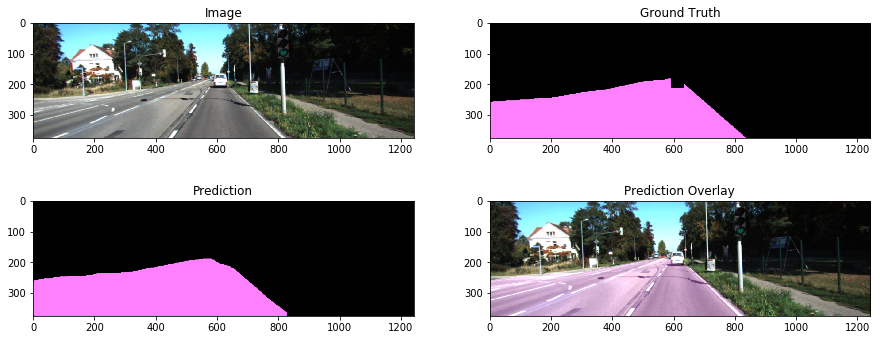



Epoch 21/100. . . Steps 5/26. . . Train Loss 0.02582. . . Train IOU 0.9452
Epoch 21/100. . . Steps 10/26. . . Train Loss 0.02332. . . Train IOU 0.9454
Epoch 21/100. . . Steps 15/26. . . Train Loss 0.02495. . . Train IOU 0.9455
Epoch 21/100. . . Steps 20/26. . . Train Loss 0.02448. . . Train IOU 0.9456
Epoch 21/100. . . Steps 25/26. . . Train Loss 0.02444. . . Train IOU 0.9457

Epoch 21/100. . . Valid Loss 0.03. . . Valid IOU 0.9464
Model Saved!
Displaying example validation predictions...


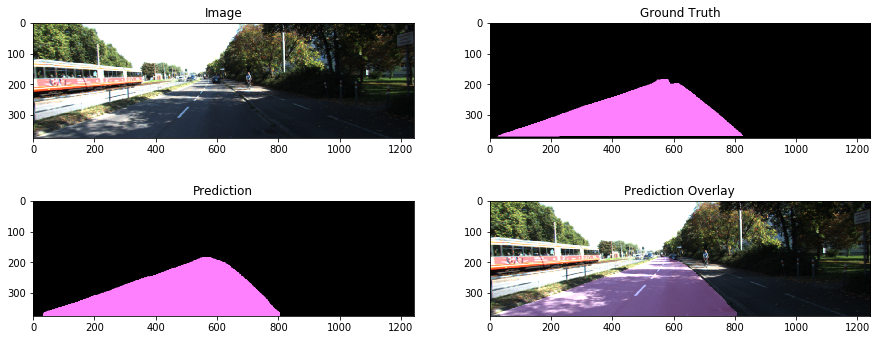

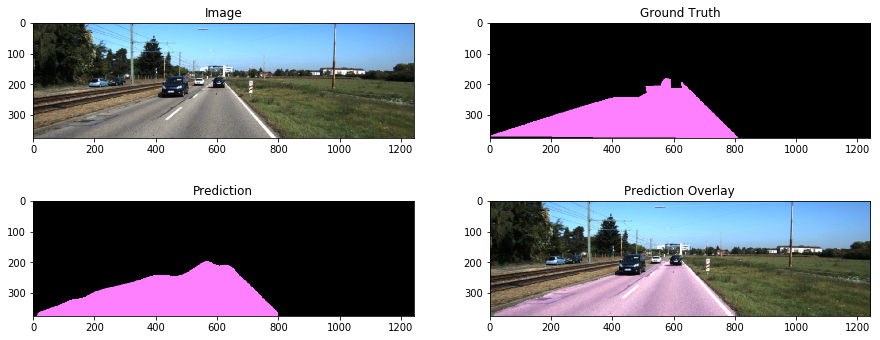

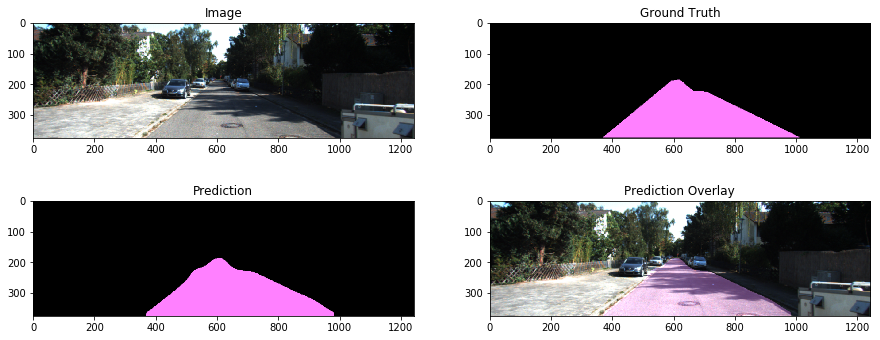



Epoch 22/100. . . Steps 5/26. . . Train Loss 0.02381. . . Train IOU 0.9466
Epoch 22/100. . . Steps 10/26. . . Train Loss 0.02561. . . Train IOU 0.9467
Epoch 22/100. . . Steps 15/26. . . Train Loss 0.02568. . . Train IOU 0.9468
Epoch 22/100. . . Steps 20/26. . . Train Loss 0.02586. . . Train IOU 0.947
Epoch 22/100. . . Steps 25/26. . . Train Loss 0.02541. . . Train IOU 0.9471

Epoch 22/100. . . Valid Loss 0.02963. . . Valid IOU 0.9477
Model Saved!
Displaying example validation predictions...


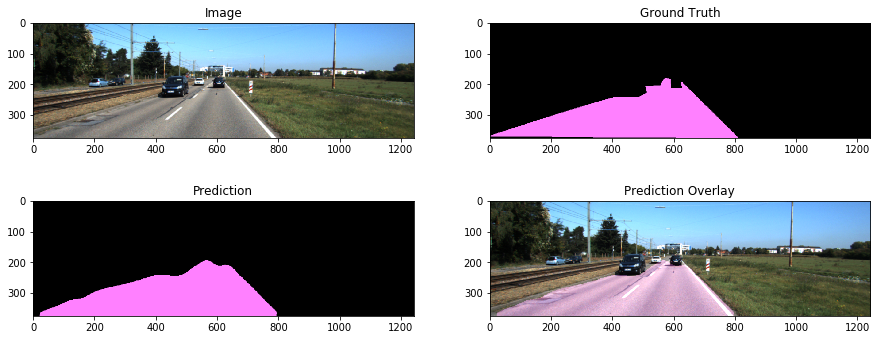

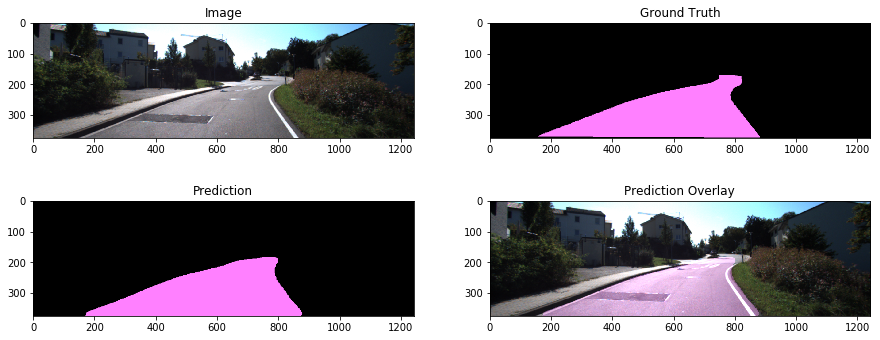

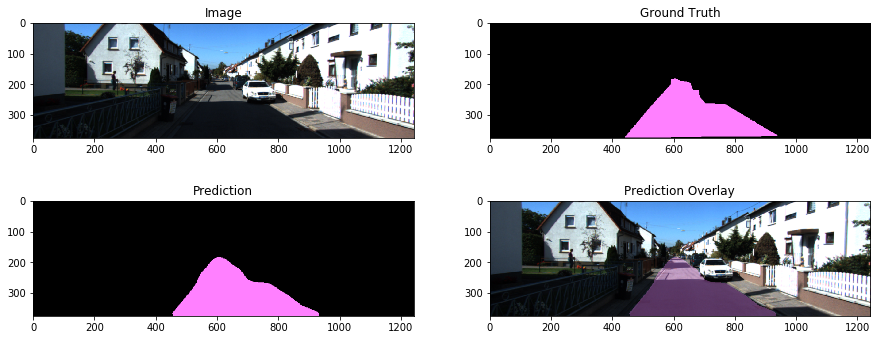



Epoch 23/100. . . Steps 5/26. . . Train Loss 0.02562. . . Train IOU 0.9479
Epoch 23/100. . . Steps 10/26. . . Train Loss 0.02368. . . Train IOU 0.948
Epoch 23/100. . . Steps 15/26. . . Train Loss 0.0227. . . Train IOU 0.9481
Epoch 23/100. . . Steps 20/26. . . Train Loss 0.02406. . . Train IOU 0.9482
Epoch 23/100. . . Steps 25/26. . . Train Loss 0.02428. . . Train IOU 0.9483

Epoch 23/100. . . Valid Loss 0.02773. . . Valid IOU 0.9489
Model Saved!
Displaying example validation predictions...


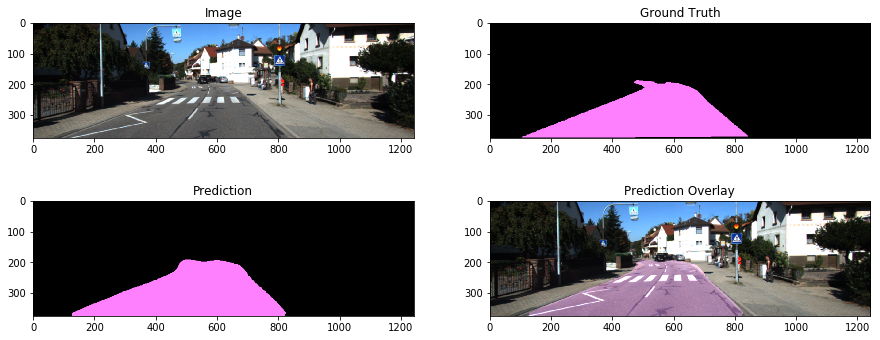

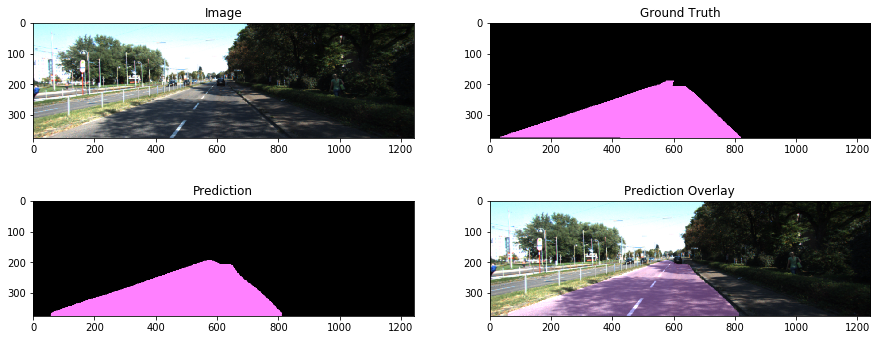

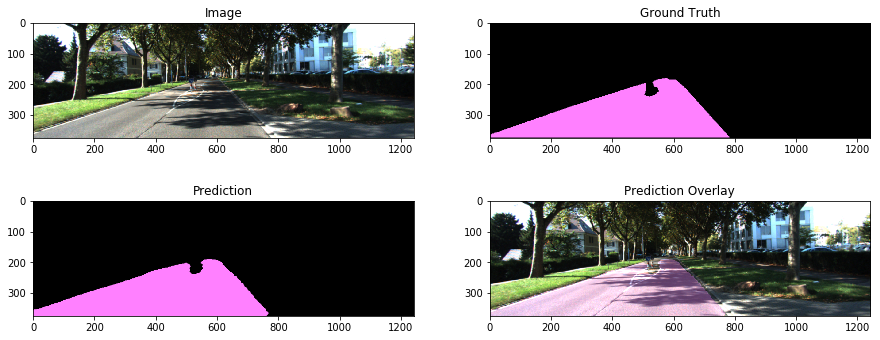



Epoch 24/100. . . Steps 5/26. . . Train Loss 0.02252. . . Train IOU 0.9491
Epoch 24/100. . . Steps 10/26. . . Train Loss 0.02274. . . Train IOU 0.9492
Epoch 24/100. . . Steps 15/26. . . Train Loss 0.02113. . . Train IOU 0.9493
Epoch 24/100. . . Steps 20/26. . . Train Loss 0.02127. . . Train IOU 0.9494
Epoch 24/100. . . Steps 25/26. . . Train Loss 0.02133. . . Train IOU 0.9495

Epoch 24/100. . . Valid Loss 0.02625. . . Valid IOU 0.95
Model Saved!
Displaying example validation predictions...


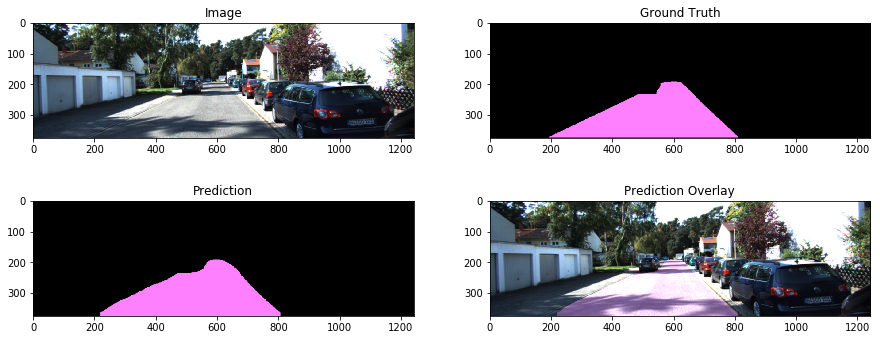

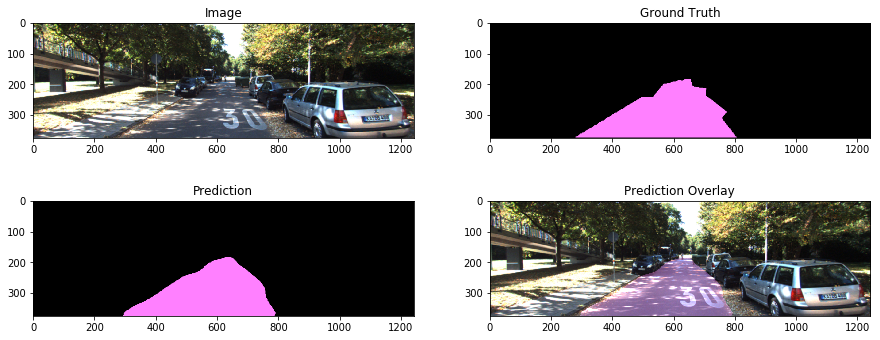

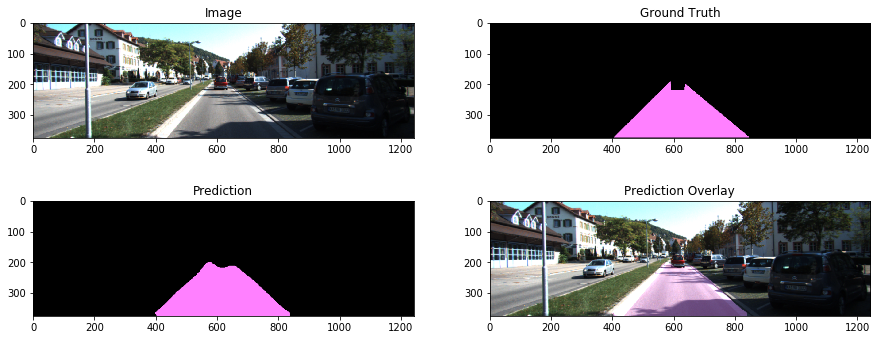



Epoch 25/100. . . Steps 5/26. . . Train Loss 0.02243. . . Train IOU 0.9502
Epoch 25/100. . . Steps 10/26. . . Train Loss 0.021. . . Train IOU 0.9503
Epoch 25/100. . . Steps 15/26. . . Train Loss 0.02104. . . Train IOU 0.9504
Epoch 25/100. . . Steps 20/26. . . Train Loss 0.02073. . . Train IOU 0.9505
Epoch 25/100. . . Steps 25/26. . . Train Loss 0.02065. . . Train IOU 0.9505

Epoch 25/100. . . Valid Loss 0.02543. . . Valid IOU 0.951
Model Saved!
Displaying example validation predictions...


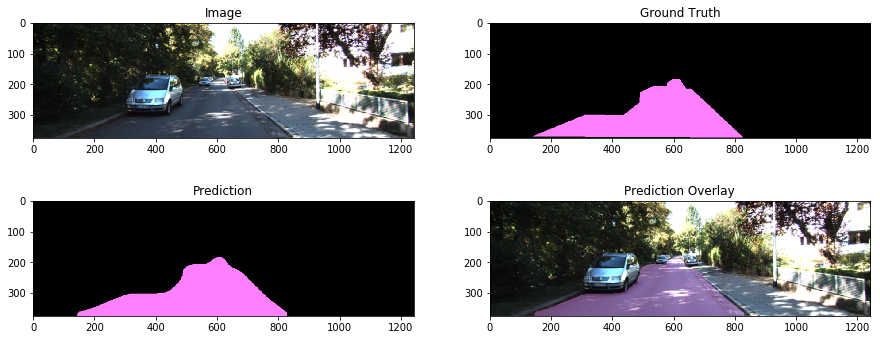

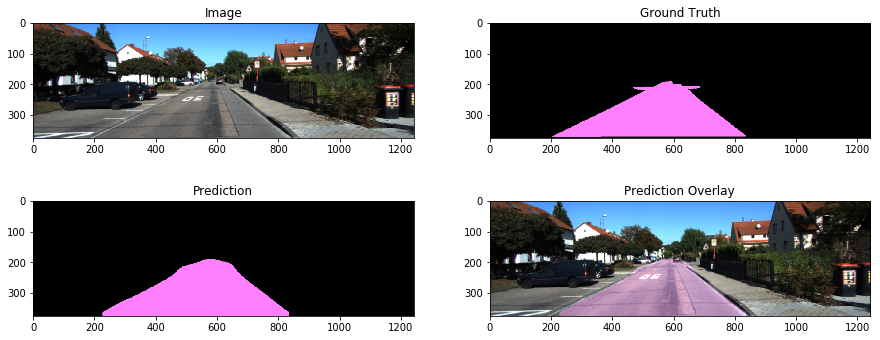

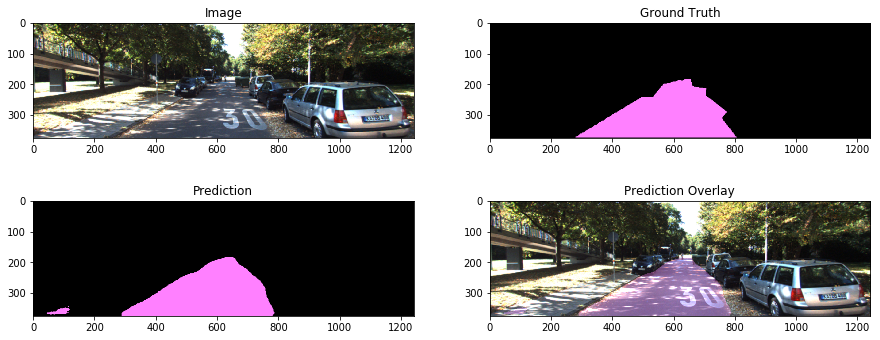



Epoch 26/100. . . Steps 5/26. . . Train Loss 0.02314. . . Train IOU 0.9511
Epoch 26/100. . . Steps 10/26. . . Train Loss 0.0204. . . Train IOU 0.9512
Epoch 26/100. . . Steps 15/26. . . Train Loss 0.01974. . . Train IOU 0.9513
Epoch 26/100. . . Steps 20/26. . . Train Loss 0.01981. . . Train IOU 0.9514
Epoch 26/100. . . Steps 25/26. . . Train Loss 0.01926. . . Train IOU 0.9515

Epoch 26/100. . . Valid Loss 0.02628. . . Valid IOU 0.952
Model Saved!
Displaying example validation predictions...


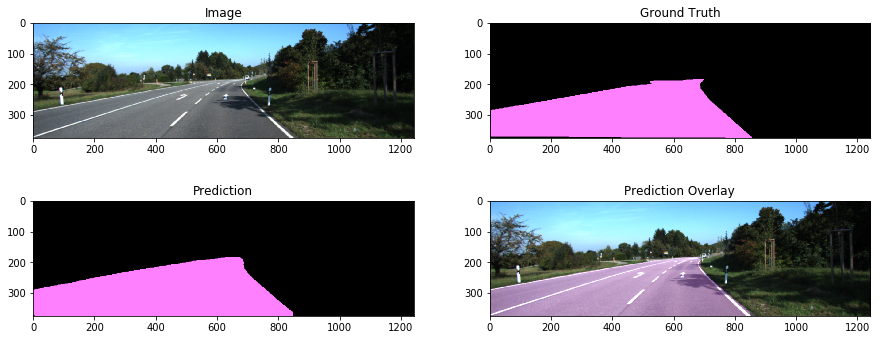

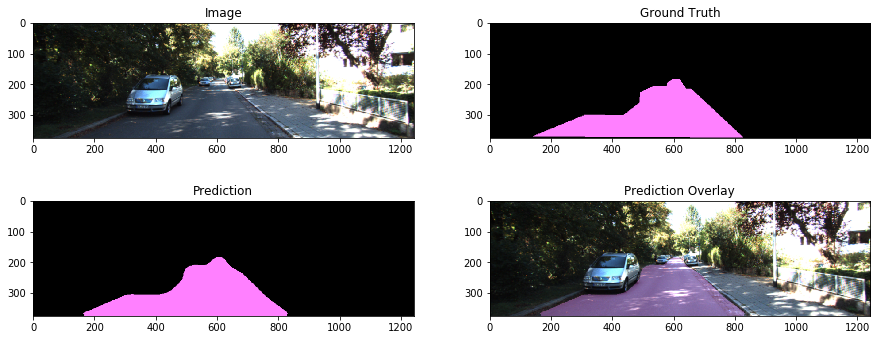

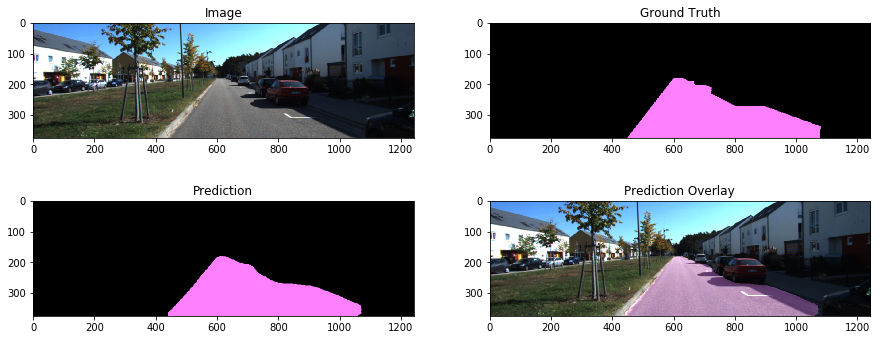



Epoch 27/100. . . Steps 5/26. . . Train Loss 0.02296. . . Train IOU 0.9522
Epoch 27/100. . . Steps 10/26. . . Train Loss 0.02101. . . Train IOU 0.9522
Epoch 27/100. . . Steps 15/26. . . Train Loss 0.02068. . . Train IOU 0.9523
Epoch 27/100. . . Steps 20/26. . . Train Loss 0.02233. . . Train IOU 0.9523
Epoch 27/100. . . Steps 25/26. . . Train Loss 0.0224. . . Train IOU 0.9524

Epoch 27/100. . . Valid Loss 0.02932. . . Valid IOU 0.9528
Model Saved!
Displaying example validation predictions...


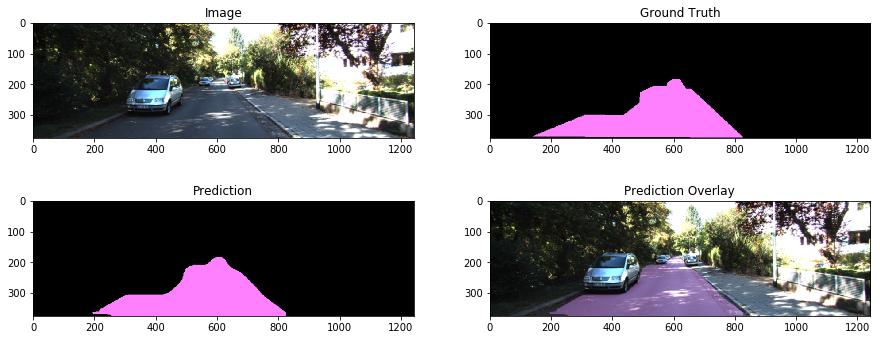

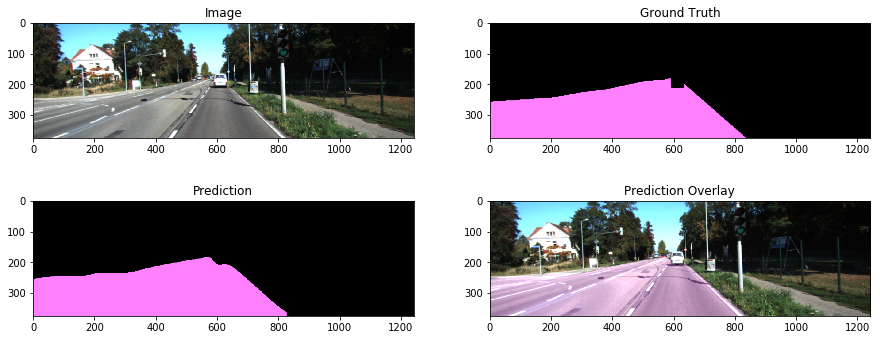

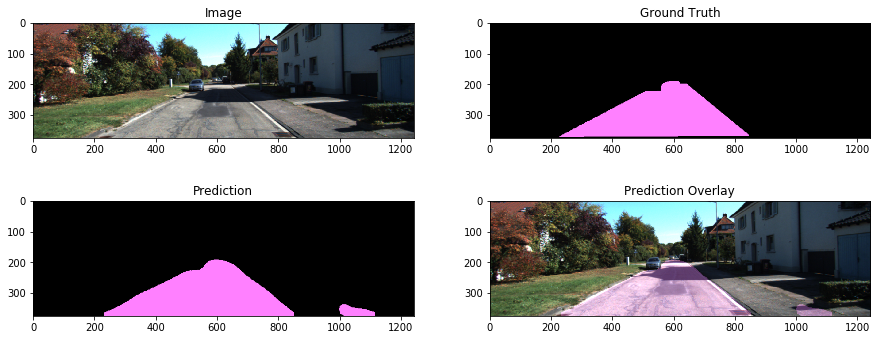



Epoch 28/100. . . Steps 5/26. . . Train Loss 0.02106. . . Train IOU 0.9528
Epoch 28/100. . . Steps 10/26. . . Train Loss 0.02034. . . Train IOU 0.9529
Epoch 28/100. . . Steps 15/26. . . Train Loss 0.021. . . Train IOU 0.953
Epoch 28/100. . . Steps 20/26. . . Train Loss 0.02098. . . Train IOU 0.9531
Epoch 28/100. . . Steps 25/26. . . Train Loss 0.02206. . . Train IOU 0.9531

Epoch 28/100. . . Valid Loss 0.0275. . . Valid IOU 0.9534
Model Saved!
Displaying example validation predictions...


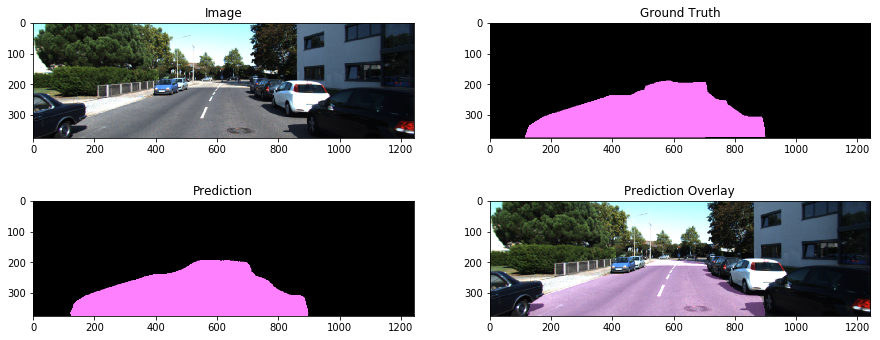

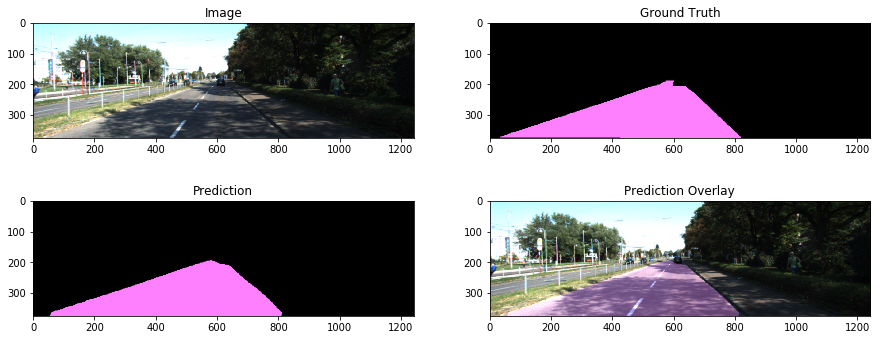

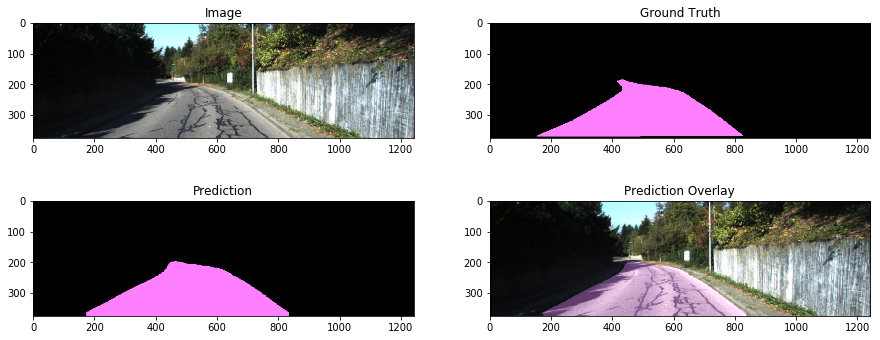



Epoch 29/100. . . Steps 5/26. . . Train Loss 0.02615. . . Train IOU 0.9535
Epoch 29/100. . . Steps 10/26. . . Train Loss 0.02375. . . Train IOU 0.9535
Epoch 29/100. . . Steps 15/26. . . Train Loss 0.02351. . . Train IOU 0.9536
Epoch 29/100. . . Steps 20/26. . . Train Loss 0.02387. . . Train IOU 0.9536
Epoch 29/100. . . Steps 25/26. . . Train Loss 0.02922. . . Train IOU 0.9536

Epoch 29/100. . . Valid Loss 0.04726. . . Valid IOU 0.9534
Displaying example validation predictions...


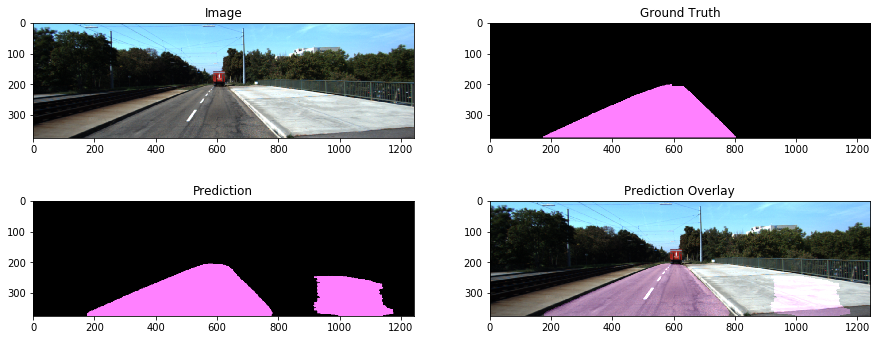

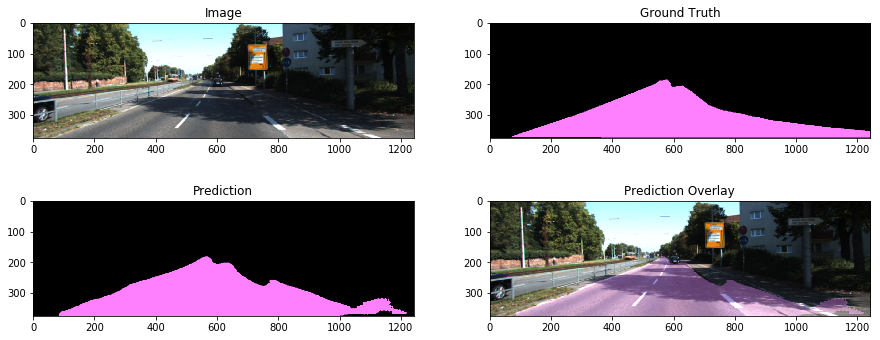

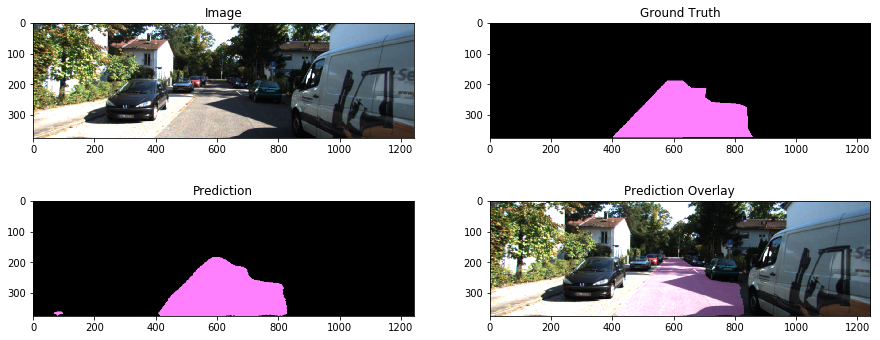



Epoch 30/100. . . Steps 5/26. . . Train Loss 0.04092. . . Train IOU 0.9533
Epoch 30/100. . . Steps 10/26. . . Train Loss 0.04139. . . Train IOU 0.9532
Epoch 30/100. . . Steps 15/26. . . Train Loss 0.04022. . . Train IOU 0.9531
Epoch 30/100. . . Steps 20/26. . . Train Loss 0.03952. . . Train IOU 0.953
Epoch 30/100. . . Steps 25/26. . . Train Loss 0.03783. . . Train IOU 0.9529

Epoch 30/100. . . Valid Loss 0.03746. . . Valid IOU 0.9526
Displaying example validation predictions...


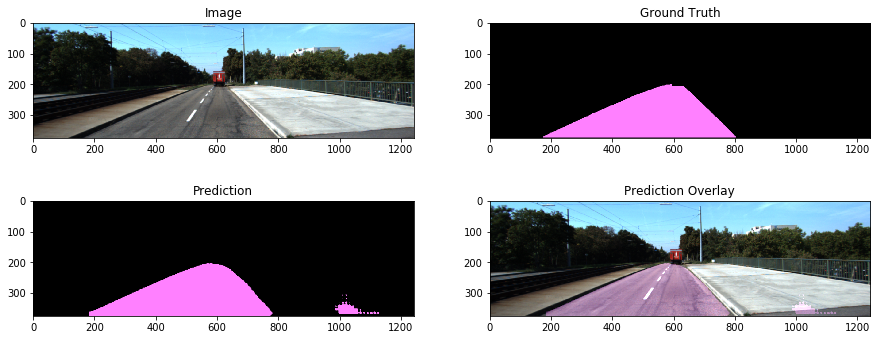

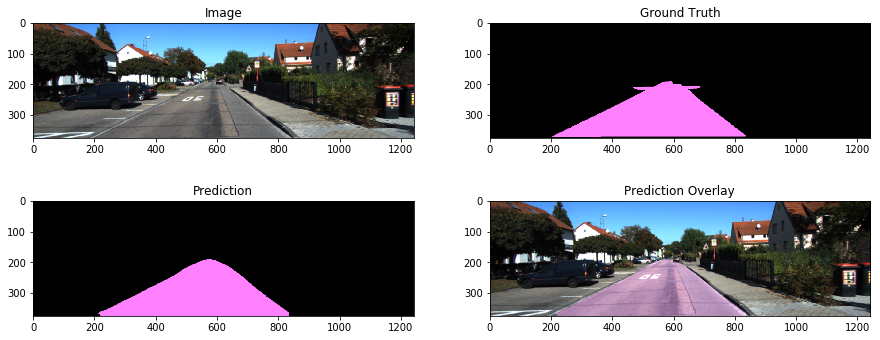

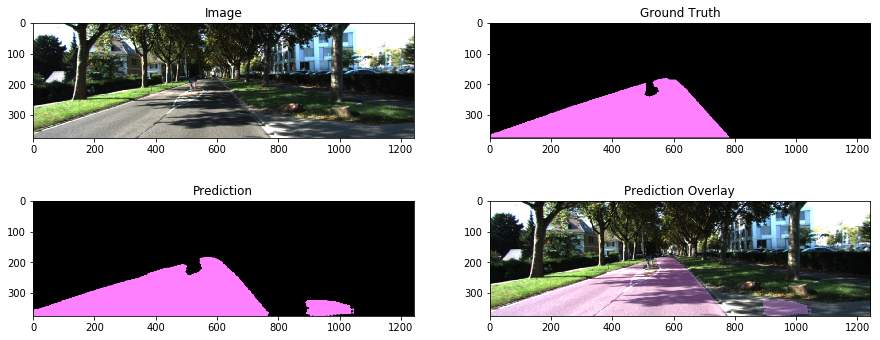



Epoch 31/100. . . Steps 5/26. . . Train Loss 0.03475. . . Train IOU 0.9525
Epoch 31/100. . . Steps 10/26. . . Train Loss 0.03486. . . Train IOU 0.9525
Epoch 31/100. . . Steps 15/26. . . Train Loss 0.03368. . . Train IOU 0.9525
Epoch 31/100. . . Steps 20/26. . . Train Loss 0.03259. . . Train IOU 0.9525
Epoch 31/100. . . Steps 25/26. . . Train Loss 0.03042. . . Train IOU 0.9525

Epoch 31/100. . . Valid Loss 0.03085. . . Valid IOU 0.9525
Displaying example validation predictions...


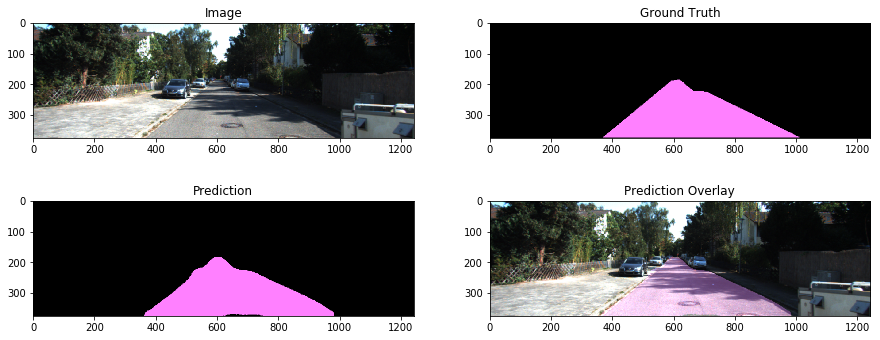

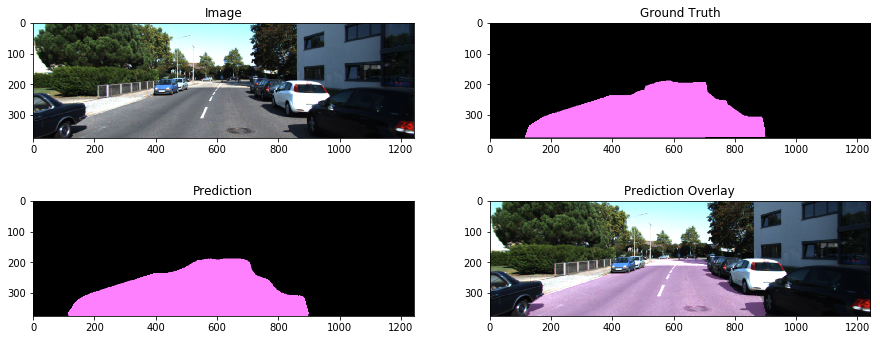

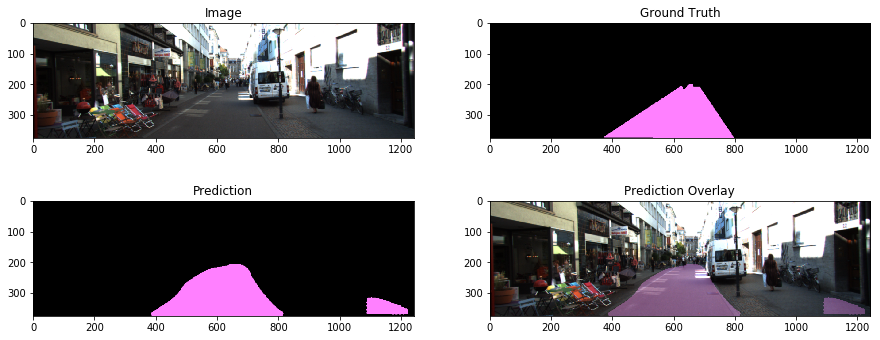



Epoch 32/100. . . Steps 5/26. . . Train Loss 0.02456. . . Train IOU 0.9525
Epoch 32/100. . . Steps 10/26. . . Train Loss 0.02733. . . Train IOU 0.9526
Epoch 32/100. . . Steps 15/26. . . Train Loss 0.02731. . . Train IOU 0.9526
Epoch 32/100. . . Steps 20/26. . . Train Loss 0.02682. . . Train IOU 0.9526
Epoch 32/100. . . Steps 25/26. . . Train Loss 0.02697. . . Train IOU 0.9526

Epoch 32/100. . . Valid Loss 0.02751. . . Valid IOU 0.9528
Displaying example validation predictions...


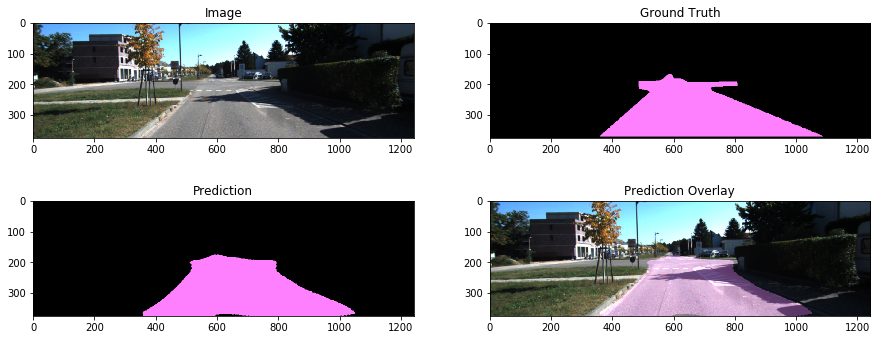

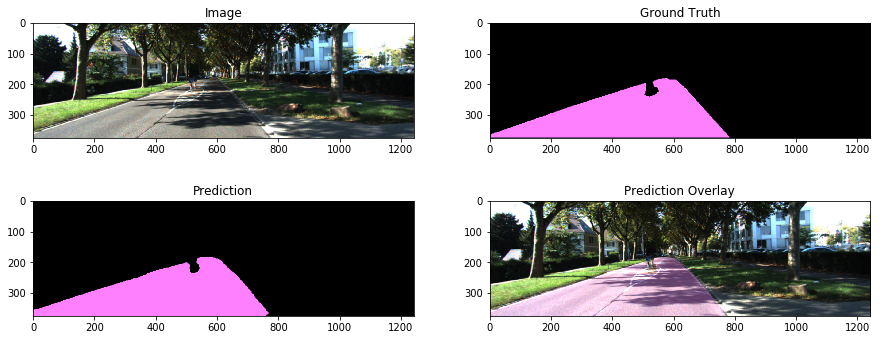

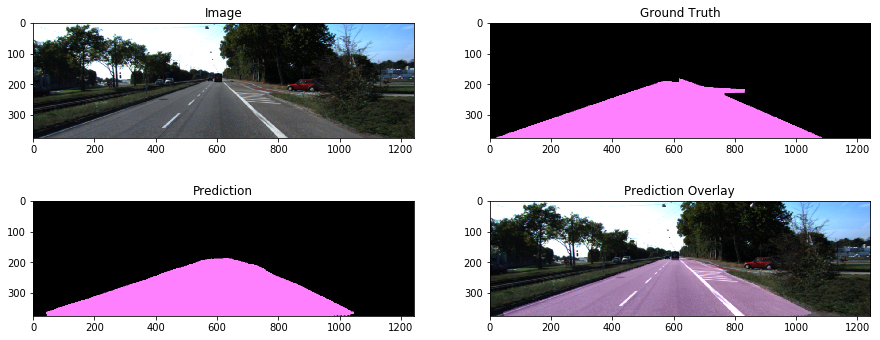



Epoch 33/100. . . Steps 5/26. . . Train Loss 0.02724. . . Train IOU 0.9528
Epoch 33/100. . . Steps 10/26. . . Train Loss 0.02519. . . Train IOU 0.9528
Epoch 33/100. . . Steps 15/26. . . Train Loss 0.0237. . . Train IOU 0.9529
Epoch 33/100. . . Steps 20/26. . . Train Loss 0.02442. . . Train IOU 0.9529
Epoch 33/100. . . Steps 25/26. . . Train Loss 0.02424. . . Train IOU 0.9529

Epoch 33/100. . . Valid Loss 0.02745. . . Valid IOU 0.9531
Displaying example validation predictions...


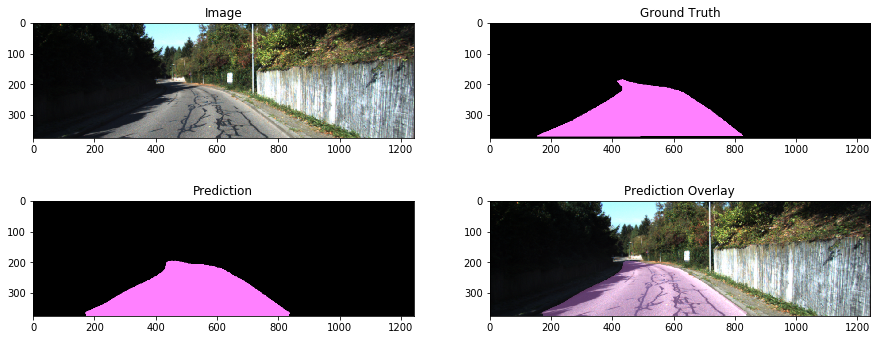

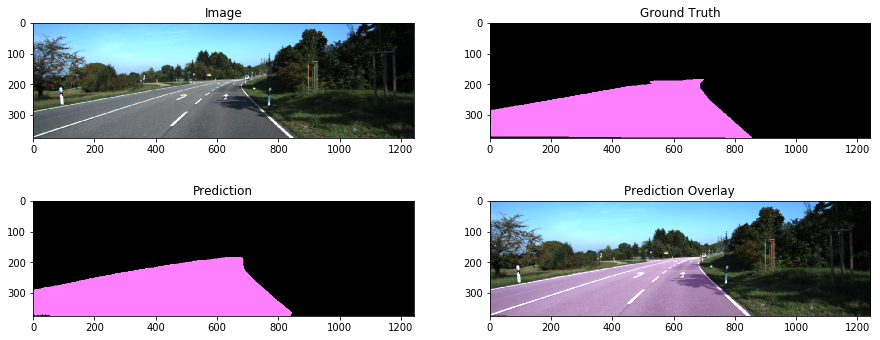

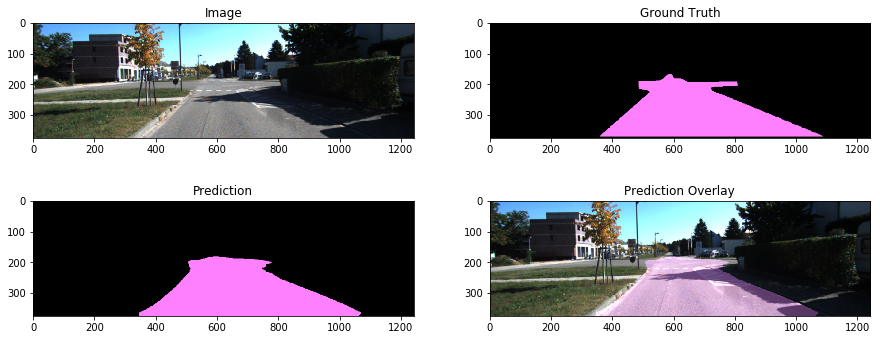



Epoch 34/100. . . Steps 5/26. . . Train Loss 0.026. . . Train IOU 0.9531
Epoch 34/100. . . Steps 10/26. . . Train Loss 0.0237. . . Train IOU 0.9531
Epoch 34/100. . . Steps 15/26. . . Train Loss 0.02292. . . Train IOU 0.9532
Epoch 34/100. . . Steps 20/26. . . Train Loss 0.02399. . . Train IOU 0.9532
Epoch 34/100. . . Steps 25/26. . . Train Loss 0.0233. . . Train IOU 0.9532

Epoch 34/100. . . Valid Loss 0.03557. . . Valid IOU 0.9533
Displaying example validation predictions...


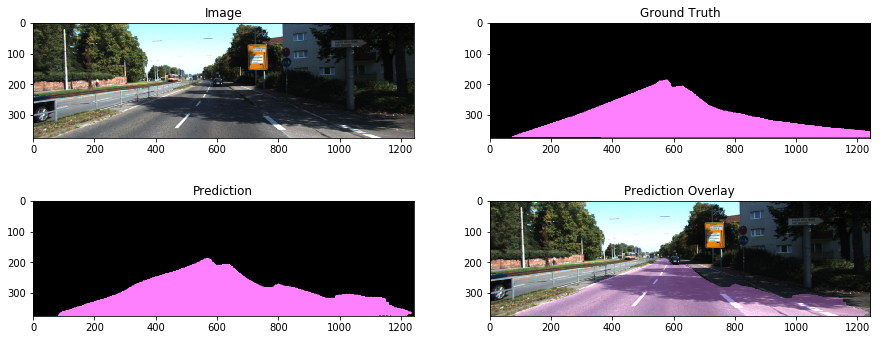

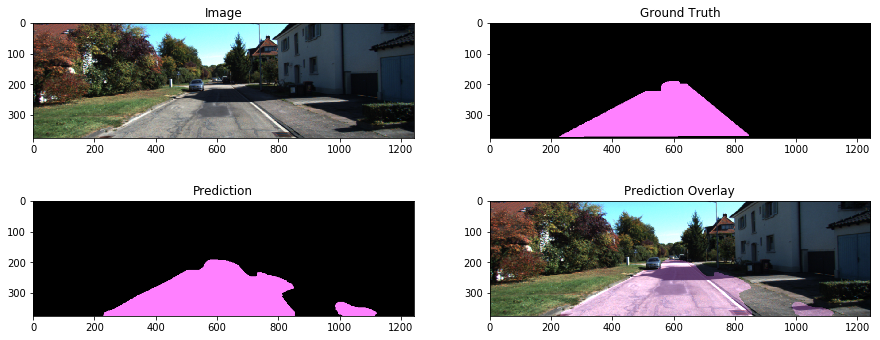

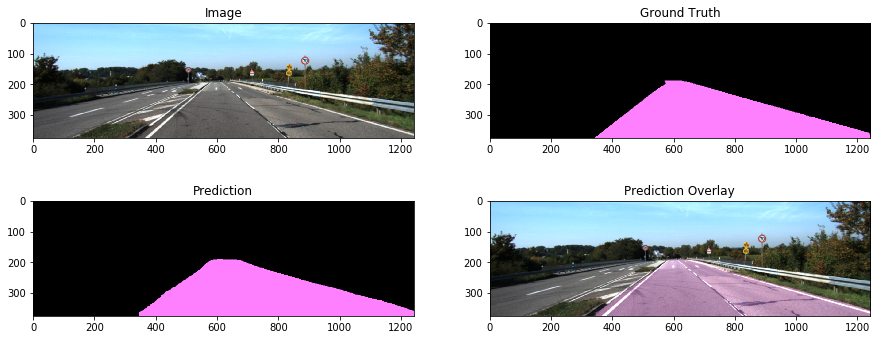



Epoch 35/100. . . Steps 5/26. . . Train Loss 0.02434. . . Train IOU 0.9534
Epoch 35/100. . . Steps 10/26. . . Train Loss 0.02196. . . Train IOU 0.9534
Epoch 35/100. . . Steps 15/26. . . Train Loss 0.02321. . . Train IOU 0.9535


KeyboardInterrupt: 

In [9]:
## This was a separate run on the KITTI dataset, saved here for your viewing pleasure
_,_,_ = run(mode='KITTI', display_val=True, load_dir='checks_KITTI', save_dir='checks_KITTI')